In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
%cd /content/drive/MyDrive/Parkinson

/content/drive/MyDrive/Parkinson


### Settings

In [ ]:
!pip install drawnow

In [58]:
import os
import pandas as pd
import numpy as np
import random, re

import matplotlib.pyplot as plt
from drawnow import *
import seaborn as sns

pd.options.display.max_rows = 100
pd.options.display.max_columns = 50

In [6]:
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)

seed_everything()

In [7]:
HEAD = ['LFHD', 'RFHD', 'LBHD', 'RBHD']  # 머리 앞뒤
CENTER = ['C7', 'CLAV', 'STRN', 'T10']   # 7번경추, 쇄골, 명치, 10번흉추
WING = ['RBAK']  # 날개뼈

SHOULDER = ['LSHO', 'RSHO'] # 어깨
UPARM = ['LUPA', 'RUPA']    # 위팔
ELBOW = ['LELB', 'RELB']    # 팔꿈치
FOREARM = ['LFRM', 'RFRM']  # 아래팔
WRIST = ['LWRA', 'RWRA', 'LWRB', 'RWRB'] # 손목
FINGER = ['LFIN', 'RFIN']   # 손가락

SINGLE = CENTER + WING  # 한쪽만 존재하는 부위
DOUBLE = HEAD + SHOULDER + UPARM + ELBOW + FOREARM + WRIST + FINGER  # 양쪽인 부위
UPPERBODY = SINGLE + DOUBLE  # 상-체

print(f'Upper Body: {len(UPPERBODY)} = Single {len(SINGLE)} + Double {len(DOUBLE)// 2 }*2')

BODY = HEAD + CENTER + WING
ARMS = SHOULDER + UPARM + ELBOW + FOREARM + WRIST + FINGER

LEGS = ['LASI', 'RASI', 'LPSI', 'RPSI',  # 골반 앞뒤
        'LTHI', 'RTHI',  # 대퇴 -> 마커 부착 시 높이차 존재하는 듯
        'LKNE', 'RKNE',  # 무릎
        'LTIB', 'RTIB',  # 정강이 -> 마커 부착 시 높이차 존재하는 듯
        'LHEE', 'RHEE',  # 발뒤꿈치
        'LANK', 'RANK',  # 복사뼈
        'LTOE', 'RTOE',  # 발가락
        ]

ALL = BODY + ARMS + LEGS
print(f'BODY {len(BODY)} + ARMS {len(ARMS)} + LEGS {len(LEGS)} = ALL {len(ALL)}')

# Left - Right Paired Markers
PAIR = HEAD + SHOULDER + UPARM + ELBOW + FOREARM + WRIST + FINGER + LEGS
print(f"Paired Markers: {len(PAIR)//2}")

Upper Body: 23 = Single 5 + Double 9*2
BODY 9 + ARMS 14 + LEGS 16 = ALL 39
Paired Markers: 17


### Data Sampling
피실험자 데이터 랜덤으로 불러오기

In [8]:
#===== Config =====#
n_sample = 5
walk_direction = 'FW'

In [9]:
df_info = pd.read_csv("csv_info.csv")
df_info['Category'].value_counts()

PD          83
Controls    22
Name: Category, dtype: int64

In [10]:
def dataSampling(df, ptype, n_sample, walk_direction):
    sampled_df = df.loc[df['Category']==ptype].sample(n_sample)
    
    sampled_paths = []  # 랜덤추출한 참여자별 FW/BW 데이터 하나씩 선택
    for id in sampled_df.index:
        paths = list(map(lambda s: s.strip(), re.sub("'", "", sampled_df.loc[id, 'path'+walk_direction][1:-1]).split(',')))
        sampled_paths.extend(random.sample(paths, 1))
    
    return sampled_paths, list(sampled_df['Participant'])

In [11]:
paths_PD, _ = dataSampling(df_info, 'PD', n_sample, walk_direction)
paths_Ctrl, _ = dataSampling(df_info, 'Controls', n_sample, walk_direction)
paths_PD, paths_Ctrl

(['./Prep/PD/JYS1_FW3.csv',
  './Prep/PD/AMJ_FW1.csv',
  './Prep/PD/JJJ_FW1.csv',
  './Prep/PD/KBJ_FW3.csv',
  './Prep/PD/HHN_FW2.csv'],
 ['./Prep/Controls/JHY_FW1.csv',
  './Prep/Controls/CHH_FW1.csv',
  './Prep/Controls/JJG_FW1.csv',
  './Prep/Controls/JKJ_FW3.csv',
  './Prep/Controls/PSW_FW1.csv'])

In [84]:
# 각 환자군별 샘플링 데이터를 리스트로 저장
def getDataList(paths):
    data = []  # list of dataframes
    info = []  # (name_trial)

    for path in paths:
        ptype = path[:-4].split('/')[2]
        information = path[:-4].split('/')[-1]
        info.append((ptype, information))
        name, trial = information.split('_')
        print(f'[INFO] Type: {ptype}, Name: {name}, Trial: {trial}')
        
        df = pd.read_csv(path)
        df.rename(columns={"Unnamed: 0": "Frame"}, inplace=True)
        data.append(df)
        
    return data, info

In [85]:
data_PD, info_PD = getDataList(paths_PD)
data_Ctrl, info_Ctrl = getDataList(paths_Ctrl)

[INFO] Type: PD, Name: JYS1, Trial: FW3
[INFO] Type: PD, Name: AMJ, Trial: FW1
[INFO] Type: PD, Name: JJJ, Trial: FW1
[INFO] Type: PD, Name: KBJ, Trial: FW3
[INFO] Type: PD, Name: HHN, Trial: FW2
[INFO] Type: Controls, Name: JHY, Trial: FW1
[INFO] Type: Controls, Name: CHH, Trial: FW1
[INFO] Type: Controls, Name: JJG, Trial: FW1
[INFO] Type: Controls, Name: JKJ, Trial: FW3
[INFO] Type: Controls, Name: PSW, Trial: FW1


In [86]:
print(info_PD[0])
data_PD[0].head(7)

('PD', 'JYS1_FW3')


,Frame,LFHD_X,LFHD_Y,LFHD_Z,RFHD_X,RFHD_Y,RFHD_Z,LBHD_X,LBHD_Y,LBHD_Z,RBHD_X,RBHD_Y,RBHD_Z,C7_X,C7_Y,C7_Z,T10_X,T10_Y,T10_Z,CLAV_X,CLAV_Y,CLAV_Z,STRN_X,STRN_Y,STRN_Z,...,LANK_Z,LHEE_X,LHEE_Y,LHEE_Z,LTOE_X,LTOE_Y,LTOE_Z,RTHI_X,RTHI_Y,RTHI_Z,RKNE_X,RKNE_Y,RKNE_Z,RTIB_X,RTIB_Y,RTIB_Z,RANK_X,RANK_Y,RANK_Z,RHEE_X,RHEE_Y,RHEE_Z,RTOE_X,RTOE_Y,RTOE_Z
0,247,NaN,NaN,NaN,198.956741,-1855.951660,1561.082275,50.559006,-1998.878540,1552.722778,179.189148,-2023.107300,1546.954834,120.695595,-2022.321899,1416.596680,109.951416,-2125.612549,1161.913208,103.591759,-1897.563477,1322.962280,101.213783,-1875.705444,1099.914063,...,192.077866,-0.271202,-2177.355469,207.259583,-48.215954,-2051.006836,71.510437,272.988464,-2011.134399,731.901917,254.868500,-1986.667236,406.800934,257.865692,-2007.102295,296.721527,200.558136,-2041.717041,62.340080,143.323334,-2080.098145,44.341187,195.267685,-1890.740112,33.077354
1,248,NaN,NaN,NaN,198.965927,-1855.644287,1561.073853,50.565102,-1998.571899,1552.718262,179.192459,-2022.812134,1546.977173,120.715546,-2022.028198,1416.599487,109.972710,-2125.345459,1161.926270,103.612045,-1897.275879,1322.951904,101.293083,-1875.420044,1099.922852,...,191.880295,-0.283794,-2176.631104,206.979004,-48.174431,-2050.068604,71.450874,272.993408,-2010.935547,731.900635,254.877029,-1986.589478,406.796967,257.877045,-2007.049072,296.723206,200.559830,-2041.713257,62.349037,143.321304,-2080.096924,44.346420,195.267700,-1890.739624,33.077782
2,249,NaN,NaN,NaN,199.012344,-1854.284546,1561.035889,50.600132,-1997.207031,1552.708008,179.217407,-2021.485352,1547.055664,120.796387,-2020.718994,1416.610596,110.055679,-2124.140381,1161.978882,103.708488,-1895.979736,1322.903442,101.614014,-1874.148560,1099.951782,...,190.955185,-0.331434,-2173.359619,205.711731,-48.009953,-2045.840942,71.170990,273.019775,-2010.050781,731.886536,254.908615,-1986.231934,406.773804,257.911865,-2006.803711,296.719055,200.562561,-2041.696289,62.384701,143.310394,-2080.092285,44.367840,195.268372,-1890.734741,33.078472
3,250,NaN,NaN,NaN,199.123093,-1851.275146,1560.945190,50.686718,-1994.163086,1552.692627,179.289978,-2018.497925,1547.187622,120.962517,-2017.797485,1416.627808,110.216026,-2121.427246,1162.084961,103.932007,-1893.058838,1322.768188,102.242859,-1871.330322,1099.981201,...,188.782684,-0.416263,-2165.964844,202.833176,-47.704006,-2036.319458,70.500664,273.092377,-2008.094360,731.835693,254.965988,-1985.418091,406.709167,257.976318,-2006.268921,296.691315,200.556442,-2041.658203,62.451588,143.279800,-2080.078125,44.403076,195.271576,-1890.721191,33.076454
4,251,NaN,NaN,NaN,199.286453,-1846.449951,1560.778320,50.821888,-1989.264526,1552.653687,179.416275,-2013.653320,1547.342285,121.206009,-2013.096069,1416.633667,110.439217,-2117.050293,1162.233765,104.279076,-1888.371582,1322.517822,103.079086,-1866.863647,1099.958862,...,185.131866,-0.489256,-2153.886475,198.049667,-47.315495,-2020.885742,69.360161,273.221924,-2004.964600,731.733765,255.043594,-1984.108398,406.595581,258.100403,-2005.450928,296.630890,200.528824,-2041.598511,62.537155,143.223816,-2080.051270,44.443001,195.270050,-1890.694336,33.064617
5,252,75.269424,-1787.110962,1561.774170,199.463089,-1839.869873,1560.501953,50.983551,-1982.625854,1552.563477,179.579361,-2007.047119,1547.483643,121.496086,-2006.717896,1416.601074,110.695358,-2111.113770,1162.389160,104.713593,-1882.074219,1322.180542,103.951569,-1860.928345,1099.815063,...,179.990875,-0.480045,-2137.186035,191.274353,-46.926586,-1999.775635,67.753143,273.390747,-2000.695679,731.577759,255.140152,-1982.347412,406.428436,258.314606,-2004.406738,296.569458,200.473938,-2041.519653,62.629028,143.143585,-2080.015869,44.491268,195.247711,-1890.651001,33.035416
6,253,75.255325,-1786.794678,1561.729614,199.641296,-1831.750244,1560.095093,51.149254,-1974.501099,1552.404053,179.749191,-1998.945557,1547.575928,121.794434,-1998.911499,1416.507446,110.954384,-2103.849365,1162.519043,105.240875,-1874.381958,1321.778687,104.806343,-1853.75561

In [87]:
print(info_Ctrl[3])
data_Ctrl[3].head(7)

('Controls', 'JKJ_FW3')


,Frame,LFHD_X,LFHD_Y,LFHD_Z,RFHD_X,RFHD_Y,RFHD_Z,LBHD_X,LBHD_Y,LBHD_Z,RBHD_X,RBHD_Y,RBHD_Z,C7_X,C7_Y,C7_Z,T10_X,T10_Y,T10_Z,CLAV_X,CLAV_Y,CLAV_Z,STRN_X,STRN_Y,STRN_Z,...,LANK_Z,LHEE_X,LHEE_Y,LHEE_Z,LTOE_X,LTOE_Y,LTOE_Z,RTHI_X,RTHI_Y,RTHI_Z,RKNE_X,RKNE_Y,RKNE_Z,RTIB_X,RTIB_Y,RTIB_Z,RANK_X,RANK_Y,RANK_Z,RHEE_X,RHEE_Y,RHEE_Z,RTOE_X,RTOE_Y,RTOE_Z
0,281,-31.065145,-1955.286987,1511.766846,83.074371,-1973.950073,1511.157959,-41.908474,-2105.636963,1530.246582,75.207787,-2122.176758,1526.286499,13.722880,-2167.416260,1335.535889,10.145892,-2240.373779,1116.143311,15.272816,-2018.228516,1270.972534,25.755512,-1972.131348,1029.488403,...,66.878609,-37.001648,-2351.305176,59.869999,-24.033651,-2165.129150,36.333164,218.101364,-2038.453857,692.849670,184.199615,-1927.693359,455.938416,191.858597,-1939.751465,337.383118,111.477211,-1960.951538,70.236824,47.927017,-1995.171143,51.638062,99.994705,-1818.885742,68.856369
1,282,-31.056715,-1954.914673,1511.733032,83.075676,-1973.524536,1511.115845,-41.881359,-2105.233154,1530.202026,75.230316,-2121.783936,1526.246338,13.749606,-2167.027588,1335.506592,10.179994,-2239.985107,1116.110962,15.326336,-2017.845581,1270.936646,25.792776,-1971.784546,1029.412354,...,66.936707,-36.975491,-2351.282227,59.931358,-24.029316,-2165.130371,36.330223,218.171753,-2038.098389,692.850464,184.226852,-1927.345947,455.859802,191.851074,-1939.155029,337.270996,111.495903,-1959.812988,70.092766,47.953846,-1994.008301,51.451664,100.032150,-1817.751587,68.941338
2,283,-31.003426,-1953.223877,1511.567627,83.121544,-1971.668579,1510.946167,-41.767818,-2103.459961,1530.019897,75.333359,-2120.021973,1526.068726,13.867561,-2165.278076,1335.355835,10.333026,-2238.244141,1115.961670,15.508077,-2016.119995,1270.752930,25.965364,-1970.165771,1029.132935,...,67.198502,-36.873070,-2351.188477,60.236687,-24.015902,-2165.134033,36.316700,218.398315,-2036.445801,692.786011,184.343674,-1925.818237,455.503082,191.890854,-1936.614990,336.811127,111.598679,-1954.783691,69.479935,48.100163,-1988.851563,50.657578,100.225861,-1812.765381,69.374886
3,284,-30.863441,-1949.405151,1511.186279,83.317955,-1967.643799,1510.592163,-41.519104,-2099.530762,1529.626587,75.574989,-2116.072754,1525.670898,14.144826,-2161.332520,1334.983276,10.682548,-2234.340088,1115.615479,15.807609,-2012.223999,1270.294067,26.294865,-1966.396484,1028.582031,...,67.774551,-36.685780,-2350.986084,60.994133,-23.997402,-2165.140625,36.288082,218.737793,-2032.637573,692.482971,184.556000,-1922.439331,454.673126,192.087509,-1931.210327,335.867432,111.930519,-1943.766113,68.274887,48.512131,-1977.500122,49.015697,100.717155,-1801.859985,70.462929
4,285,-30.613085,-1943.224976,1510.585327,83.725861,-1961.309448,1510.012207,-41.112076,-2093.193359,1528.978516,75.988609,-2109.696533,1525.020386,14.620647,-2154.948975,1334.354736,11.265051,-2228.031738,1115.029419,16.177204,-2005.898682,1269.511719,26.627792,-1960.120972,1027.714722,...,68.720154,-36.443752,-2350.632813,62.321716,-23.978983,-2165.151367,36.248558,219.112335,-2026.407227,691.807312,184.803864,-1917.049072,453.266937,192.473160,-1922.868652,334.441681,112.681816,-1926.535645,66.703804,49.329041,-1959.663330,46.644608,101.589874,-1784.785522,72.373665
5,286,-30.230890,-1934.786133,1509.761475,84.319389,-1952.772095,1509.173096,-40.545937,-2084.568604,1528.069580,76.581528,-2101.020996,1524.114624,15.293636,-2146.284912,1333.476563,12.087634,-2219.434326,1114.184326,16.577936,-1997.266113,1268.435303,26.861168,-1951.408447,1026.522583,...,70.095528,-36.179031,-2350.082764,64.249870,-23.966331,-2165.152344,36.198944,219.500961,-2017.899048,690.730164,185.074722,-1909.847656,451.274628,193.036636,-1911.952271,332.568420,113.923058,-1904.004272,65.063499,50.598698,-1936.281860,43.829243,102.856972,-1762.465942,75.126122
6,287,-29.705870,-1924.373169,1508.692993,85.022446,-1942.260620,1508.074585,-39.834507,-2074.016846,1526.924072,77.340408,-2090.380859,1522.973633,16.149065,-2135.691406,1332.358887,13.141159,-2208.8

### Relative Motion of Paired Markers

In [16]:
pairs_left = [p + '_' + axis for p in PAIR for axis in ['X','Y','Z'] if p[0]=='L']
pairs_right = [p + '_' + axis for p in PAIR for axis in ['X','Y','Z'] if p[0]=='R']
pairs = list(zip(pairs_left, pairs_right))
print(f"{len(pairs)} paired markers")

51 paired markers


In [17]:
def computeRelativePosition(df, origin:str, target:str):
    '''
    origin: Reference marker
    target: Relative movement to be observed
    '''
    return df[target] - df[origin]  # 알단 NaN 있어도 그대로 진행

In [18]:
# 각 데이터에서 페어가 있는 마커들의 상대적 변위 계산
def getRelativeDataList(data_list):
    data_rel = []

    for df in data_list:
        df_rel = pd.DataFrame(df['Frame'], columns=['Frame'])

        # Compute relative position
        for pair in pairs:
            df_rel[pair[1]] = computeRelativePosition(df, pair[0], pair[1])

        data_rel.append(df_rel)
    return data_rel

In [19]:
data_rel_PD = getRelativeDataList(data_PD)
data_rel_Ctrl = getRelativeDataList(data_Ctrl)

In [20]:
data_rel_PD[1].head(7)

,Frame,RFHD_X,RFHD_Y,RFHD_Z,RBHD_X,RBHD_Y,RBHD_Z,RSHO_X,RSHO_Y,RSHO_Z,RUPA_X,RUPA_Y,RUPA_Z,RELB_X,RELB_Y,RELB_Z,RFRM_X,RFRM_Y,RFRM_Z,RWRA_X,RWRA_Y,RWRA_Z,RWRB_X,RWRB_Y,RWRB_Z,...,RFIN_Z,RASI_X,RASI_Y,RASI_Z,RPSI_X,RPSI_Y,RPSI_Z,RTHI_X,RTHI_Y,RTHI_Z,RKNE_X,RKNE_Y,RKNE_Z,RTIB_X,RTIB_Y,RTIB_Z,RHEE_X,RHEE_Y,RHEE_Z,RANK_X,RANK_Y,RANK_Z,RTOE_X,RTOE_Y,RTOE_Z
0,473,119.525429,-3.406250,-0.572265,121.647678,-3.056274,-4.814087,312.666015,16.668213,-7.984619,NaN,NaN,NaN,496.241409,-133.673951,-28.452698,494.910049,-221.656250,-47.958008,529.260437,-257.166260,-82.121338,514.530822,-336.581299,-114.316956,...,-119.551697,254.007309,16.485352,38.713928,73.434925,0.892212,1.862183,318.019898,55.947388,42.245788,236.129433,104.685791,20.024719,NaN,NaN,NaN,22.873322,290.071899,-41.403307,130.515091,282.285523,-28.929897,115.983056,292.058471,3.819697
1,474,119.483269,-3.435425,-0.564698,121.646244,-3.051880,-4.813720,312.663956,16.663696,-7.975952,NaN,NaN,NaN,496.222809,-133.678588,-28.459594,494.896896,-221.700074,-47.905944,529.247528,-257.158203,-82.081421,514.496246,-336.568604,-114.255920,...,-119.488953,253.984306,16.469849,38.705383,73.430672,0.897461,1.854431,317.975937,55.841553,42.227601,236.191269,104.496460,20.032684,NaN,NaN,NaN,22.861387,289.991455,-41.584795,130.519340,282.213012,-29.037250,115.986213,292.047241,3.814695
2,475,119.376030,-3.514771,-0.548706,121.643189,-3.039917,-4.805054,312.654541,16.640259,-7.933228,NaN,NaN,NaN,496.030899,-133.946411,-28.391846,494.847061,-221.851562,-47.689636,529.179489,-257.171875,-81.896301,514.335052,-336.505249,-114.000732,...,-119.216126,253.890121,16.407227,38.680786,73.427501,0.904785,1.838623,317.786927,55.360962,42.138550,236.479699,103.578858,20.057373,NaN,NaN,NaN,22.819883,289.608886,-42.404163,130.563446,281.851074,-29.536052,115.971814,291.983154,3.799770
3,476,119.270520,-3.571533,-0.536255,121.644646,-3.029541,-4.775757,312.628510,16.565308,-7.822265,455.588486,-81.819580,58.465760,495.475678,-134.823608,-28.111755,494.722274,-222.059814,-47.235168,529.020630,-257.189942,-81.479492,514.012787,-336.305542,-113.473450,...,-118.622559,253.734192,16.307007,38.647949,73.432968,0.909913,1.832275,317.421158,54.278809,41.946594,237.166802,101.388672,20.098938,235.096398,167.548218,31.832642,22.749129,288.674683,-44.275905,130.663818,281.023682,-30.735760,115.900250,291.833129,3.761496
4,477,119.232635,-3.547974,-0.525268,121.653408,-3.027710,-4.714355,312.576324,16.452149,-7.626099,455.899658,-79.350464,58.779419,494.603485,-136.156617,-27.627564,494.483795,-222.185059,-46.507263,528.817596,-257.001099,-80.793335,513.592881,-335.798095,-112.655029,...,-117.695374,253.563500,16.241578,38.609802,73.443992,0.910400,1.847046,317.037094,52.564331,41.699768,238.315353,97.720337,20.137390,235.151352,167.923950,31.710769,22.664876,287.013916,-47.384196,130.772514,279.708618,-32.825779,115.785969,291.581543,3.689264
5,478,119.258758,-3.511475,-0.501587,121.663898,-3.025635,-4.615112,312.501618,16.386719,-7.362060,456.310287,-76.455201,59.193054,493.578918,-137.540894,-27.025208,494.118942,-222.084229,-45.511047,528.669632,-256.356933,-79.830627,513.097718,-334.807862,-111.513916,...,-116.461853,253.375511,16.235840,38.565369,73.458497,0.888916,1.896423,316.839524,50.321777,41.482056,239.867775,92.615845,20.136994,235.313430,167.706421,31.283203,22.596488,284.483155,-51.739702,130.884544,277.835938,-35.834656,115.680557,291.191406,3.600912
6,479,119.298916,-3.531616,-0.453613,121.679241,-3.025146,-4.480469,312.425018,16.414306,-7.053467,456.766083,-73.560180,59.671936,492.529037,-138.693359,-26.356629,493.639313,-221.624633,-44.310120,528.622101,-255.120239,-78.639038,512.571396,-333.197876,-109.989624,...,-114.939148,253.152504,16.239746,38.526367,73.474480,0.835205,1.995606,316.852707,47.665284,41.345703,241.741814,86.204346,20.086547,235.679688,166.334961,30.371658,22.590558,280.971191,-57.244579,131.076927,275.234375,-39.658264,115.643242,290.645385,3.502182


In [21]:
data_rel_Ctrl[4].head(7)

,Frame,RFHD_X,RFHD_Y,RFHD_Z,RBHD_X,RBHD_Y,RBHD_Z,RSHO_X,RSHO_Y,RSHO_Z,RUPA_X,RUPA_Y,RUPA_Z,RELB_X,RELB_Y,RELB_Z,RFRM_X,RFRM_Y,RFRM_Z,RWRA_X,RWRA_Y,RWRA_Z,RWRB_X,RWRB_Y,RWRB_Z,...,RFIN_Z,RASI_X,RASI_Y,RASI_Z,RPSI_X,RPSI_Y,RPSI_Z,RTHI_X,RTHI_Y,RTHI_Z,RKNE_X,RKNE_Y,RKNE_Z,RTIB_X,RTIB_Y,RTIB_Z,RHEE_X,RHEE_Y,RHEE_Z,RANK_X,RANK_Y,RANK_Z,RTOE_X,RTOE_Y,RTOE_Z
0,753,118.344208,-3.216797,12.224365,122.545837,-3.308715,3.424317,301.040283,-6.753296,-6.256836,460.083908,30.173462,76.313599,496.427170,138.457886,-16.932678,476.657287,214.839843,89.532165,404.942887,328.296631,90.382751,510.733833,333.361328,38.455933,...,98.350097,266.438217,-42.060669,0.052246,111.135651,-17.715943,-3.452819,336.698425,-103.899536,57.583557,289.250946,-142.493774,-23.127930,271.299653,-180.635254,107.630813,71.774811,-233.203491,-9.230492,166.772125,-250.241211,-29.364682,111.741943,-235.509033,-19.427463
1,754,118.356812,-3.208496,12.231079,122.552155,-3.290894,3.420044,301.043198,-6.805786,-6.265381,460.071457,30.284057,76.281738,496.354989,138.682251,-16.956726,476.658768,215.176148,89.569214,404.916047,328.712402,90.456788,510.683029,333.855591,38.516602,...,98.437012,266.440903,-42.097534,0.056152,111.135284,-17.732055,-3.442993,336.704025,-103.909912,57.596985,289.222168,-142.625244,-23.118073,271.307937,-181.133301,107.695938,71.810425,-234.017578,-9.064552,166.790070,-251.041992,-29.282455,111.710694,-236.323608,-19.553226
2,755,118.392181,-3.184204,12.255249,122.573548,-3.244019,3.418579,301.050095,-7.038696,-6.311035,460.012223,30.748413,76.151001,496.069076,139.691406,-17.073975,476.590271,216.640748,89.731628,404.802581,330.544800,90.787720,510.450829,335.986206,38.774536,...,98.827637,266.470154,-42.272217,0.082946,111.125915,-17.807373,-3.399170,336.738602,-103.980957,57.679993,289.095550,-143.216186,-23.075775,271.340698,-183.353272,107.959320,71.982544,-237.637085,-8.343564,166.871734,-254.588501,-28.947647,111.576263,-239.936523,-20.136741
3,756,118.432098,-3.145508,12.289795,122.604614,-3.202759,3.427978,301.044938,-7.556396,-6.421264,459.832612,31.705444,75.879151,495.480774,141.906616,-17.350464,476.393158,219.786499,90.056274,404.531891,334.529297,91.510559,509.957962,340.576294,39.285034,...,99.664978,266.527664,-42.677368,0.155640,111.097259,-17.975342,-3.314392,336.807144,-104.204590,57.902405,288.816864,-144.548584,-22.990600,271.410339,-188.283691,108.485138,72.385529,-245.659912,-6.805237,167.057525,-262.404785,-28.302208,111.294098,-247.906006,-21.489319
4,757,118.457245,-3.097168,12.320435,122.635223,-3.182007,3.431518,301.010849,-8.382080,-6.601684,459.484314,33.132568,75.450195,494.579987,145.344849,-17.813538,476.106308,224.609619,90.497315,404.050430,340.697144,92.617676,509.244881,347.695557,39.963196,...,100.903565,266.561432,-43.326050,0.283814,111.053222,-18.233764,-3.202881,336.877014,-104.658692,58.288147,288.368424,-146.710327,-22.871185,271.529510,-196.135376,109.222137,73.048309,-258.414306,-4.487915,167.349976,-274.775635,-27.444934,110.888825,-260.497315,-23.728538
5,758,118.471801,-3.059936,12.345703,122.655274,-3.169189,3.429931,300.954605,-9.460693,-6.850220,459.017685,34.944580,74.868897,493.433213,149.802979,-18.449463,475.756440,230.817138,90.977294,403.409393,348.724609,94.002930,508.366936,356.919556,40.685425,...,102.411865,266.571869,-44.169189,0.478393,111.000153,-18.572388,-3.069397,336.922058,-105.393067,58.838562,287.777343,-149.633545,-22.713135,271.720642,-206.597657,110.064224,73.957336,-275.403687,-1.592396,167.736267,-291.223511,-26.506150,110.441132,-277.176513,-26.815960
6,759,118.481109,-3.046021,12.360229,122.670166,-3.156006,3.435668,300.877975,-10.688233,-7.154053,458.483322,37.003784,74.183960,492.115204,154.951416,-19.207337,475.371978,237.971802,91.401001,402.710678,358.081787,95.494202,507.385949,367.555297,41.329773,...,104.038330,266.566925,-45.153564,0.752197,110.936127,-18.984619,-2.912842,336.929611,-106.427368,59.536805,287.140457,-153.159302,-22.494446,272.011627,-219.013550,1

### 3D Visualization

In [101]:
def plot3DMultiple(data_list, info_list, placement: str):  
    '''
    data_list: 여러 환자의 데이터프레임 리스트
    placement: 관찰하고 싶은 마커 위치
    '''

    fig, axes = plt.subplots(ncols=len(data_list), figsize=(32,6), subplot_kw={"projection":"3d"})
    plt.subplots_adjust(wspace=0.1, hspace=0.3)

    ptype = info_list[0][0]
    color_map = plt.get_cmap('GnBu') if ptype == 'PD' else plt.get_cmap('RdPu')

    i = 0
    for ax, df in zip(axes, data_list):
        X,Y,Z = df[placement+'_X'], df[placement+'_Y'], df[placement+'_Z'] 
        scatter_plot = ax.scatter3D(X, Y, Z, c=df["Frame"], cmap=color_map)
        fig.colorbar(scatter_plot, ax=ax, shrink=0.5)
        # ax.scatter(X, Y, Z, c=df["Frame"], cmap="inferno", s=5, alpha=0.5)

        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        
        ax.set_title(f'[{ptype}] {info_list[i][1]}: {placement}', fontsize=12)
        i += 1
    
    plt.show()
    return


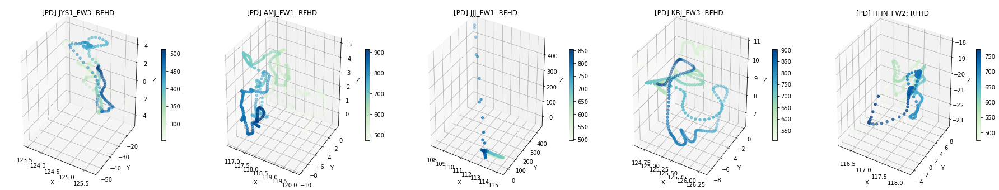

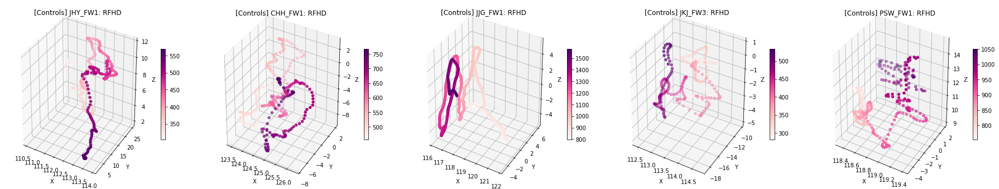

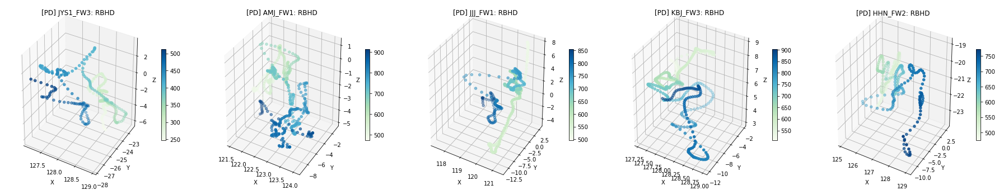

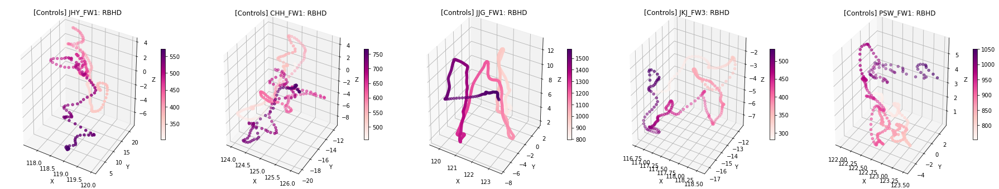

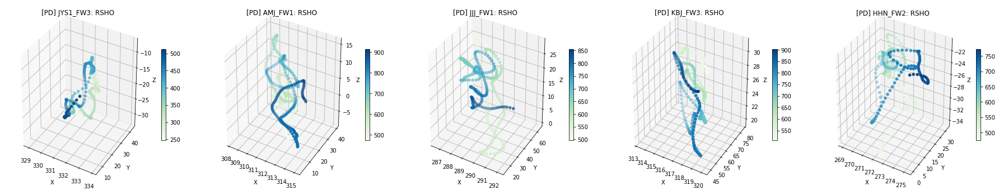

...

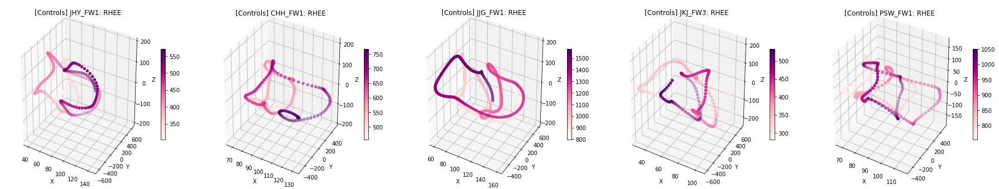

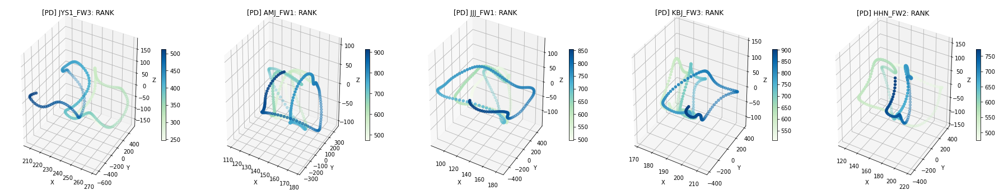

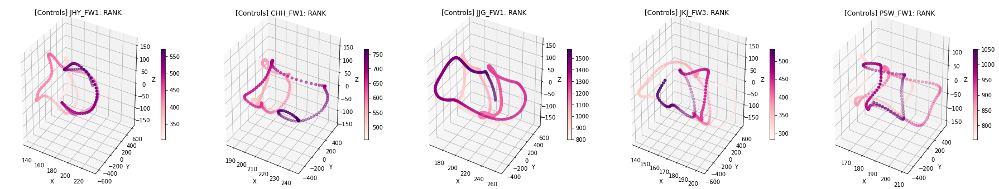

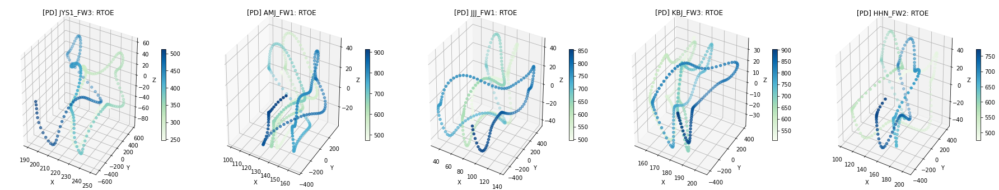

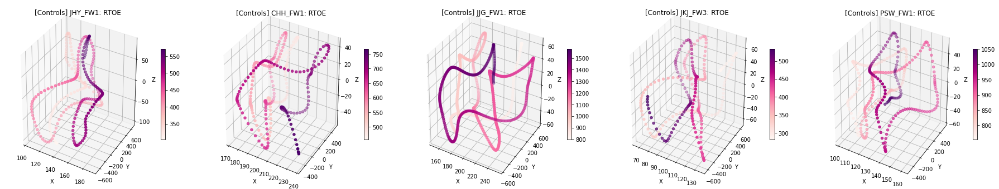

In [102]:
for placement in PAIR:
    if placement[0] == 'R':
        plot3DMultiple(data_rel_PD, info_PD, placement)
        plot3DMultiple(data_rel_Ctrl, info_Ctrl, placement)

### 2D Projection (Multiple data)
- 측면(YZ평면)만 관찰
- PD 5명, Controls 5명

In [131]:
def plotYZplaneMultiple(data_list, info_list, placement: str):  
    '''
    data_list: 여러 환자의 데이터프레임 리스트
    placement: 관찰하고 싶은 마커 위치
    '''

    fig, axes = plt.subplots(ncols=len(data_list), figsize=(32,5))
    plt.subplots_adjust(wspace=0.5, top=0.85)

    ptype = info_list[0][0]
    color_map = 'GnBu' if ptype == 'PD' else 'RdPu'

    i = 0
    for ax, df in zip(axes, data_list):
        sns.set_style('darkgrid')
        sns.scatterplot(data=df, x=placement+'_Y', y=placement+'_Z', ax=ax, hue='Frame', palette=color_map)
        
        ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        ax.set_xlabel('Y')
        ax.set_ylabel('Z')
        
        ax.set_title(f'{info_list[i][1]}: {placement}', fontsize=12)
        i += 1
    
    plt.suptitle(f'[{ptype}] Side view (YZ-plane)', fontsize=15)
    plt.show()
    return


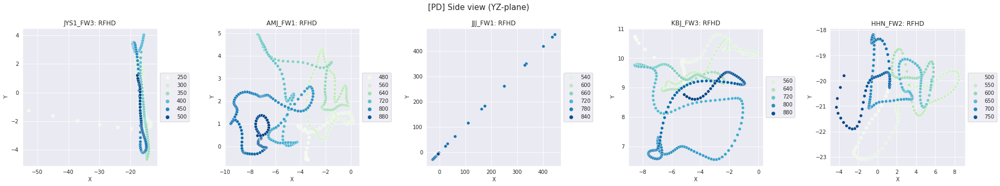

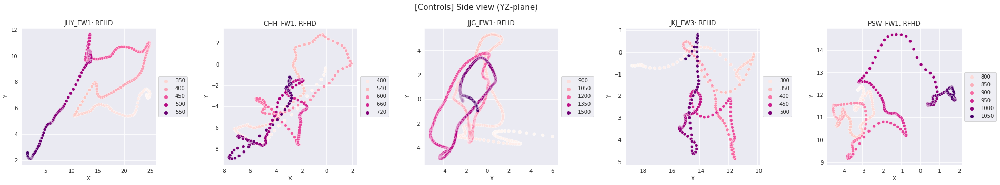

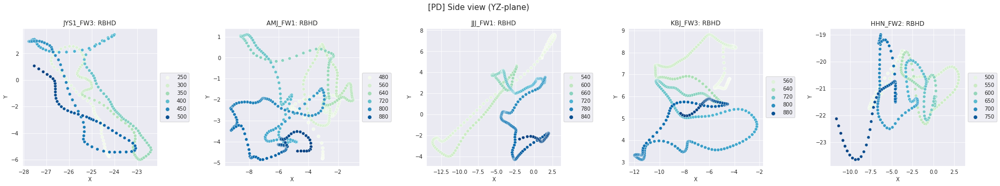

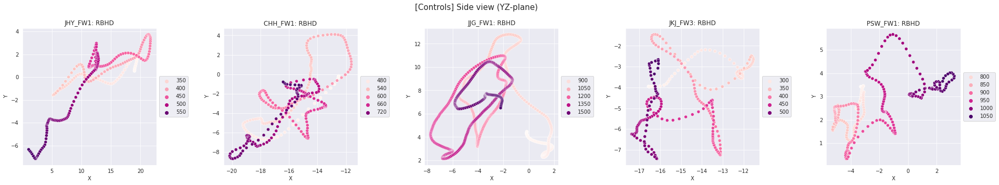

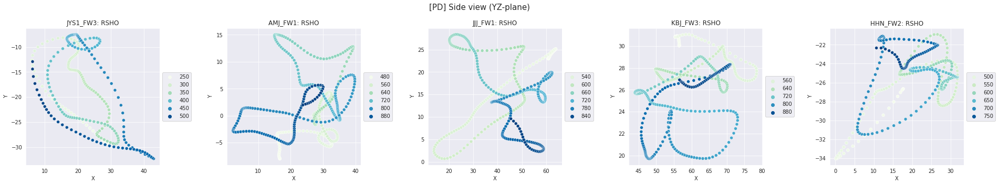

...

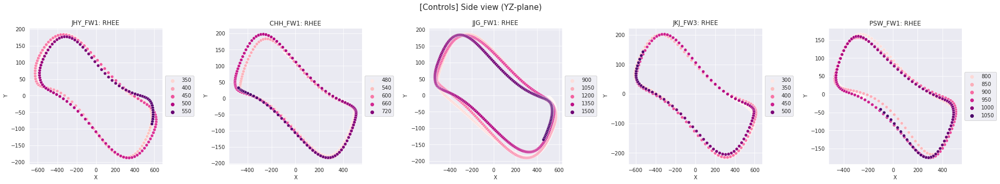

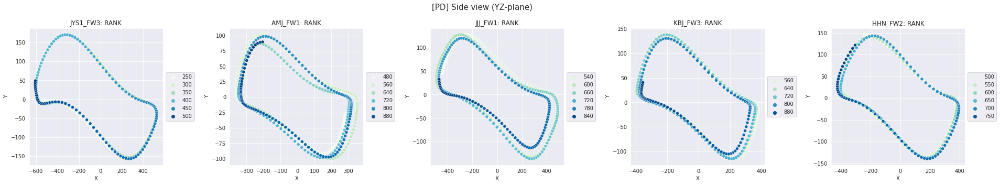

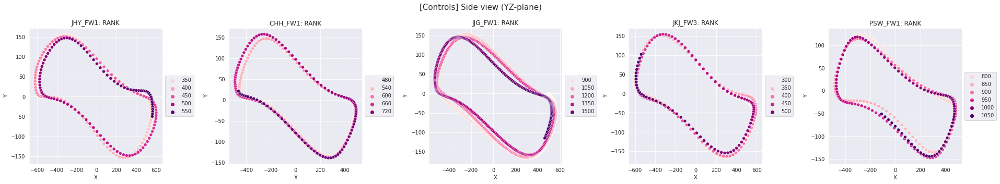

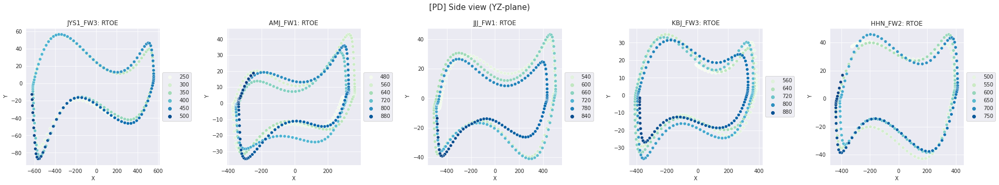

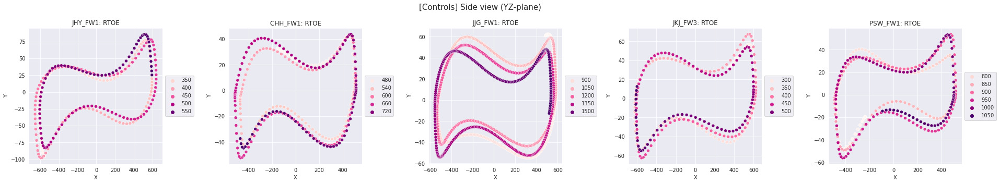

In [133]:
for placement in PAIR:
    if placement[0] == 'R':
        plotYZplaneMultiple(data_rel_PD, info_PD, placement)
        plotYZplaneMultiple(data_rel_Ctrl, info_Ctrl, placement)

### 2D Projection (Single data)
정면(XZ면), 측면(YZ평면), 윗면(XY평면) 관찰

In [104]:
def plot2Dprojection(df, placement: str):  
    '''
    placement: 관찰하고 싶은 마커 위치
    '''
    plane_pairs = {}  # X-YZ, Y-XZ, Z-XY pair 만들기
    for direction in ['X', 'Y', 'Z']:
        plane = ['X','Y','Z']
        plane.remove(direction)
        plane_pairs[direction] = ''.join(plane)

    fig = plt.figure(figsize=(8,6))
    ax1 = fig.add_subplot(2,2,1)
    ax2 = fig.add_subplot(2,2,3)
    ax3 = fig.add_subplot(2,2,4)
    axes = [ax1, ax2, ax3]
    plt.subplots_adjust(wspace=0.8, hspace=0.5)

    views = {'Top':'Z', 'Side':'X', 'Front':'Y'}
    for i, (view, direction) in enumerate(views.items()):
        axis1 = placement + '_' + plane_pairs[direction][0]
        axis2 = placement + '_' + plane_pairs[direction][1]
        
        sns.scatterplot(data=df, x=axis1, y=axis2, ax=axes[i], hue='Frame')
        axes[i].set_title(f'{view} view ({plane_pairs[direction]}-plane)')
        axes[i].legend(loc='center left', bbox_to_anchor=(1, 0.5))
        sns.set_style('darkgrid')
        

    # plt.suptitle(f'{placement}_X,Y,Z values in {walk_order} trial of {name}', fontsize=14)
    plt.show()

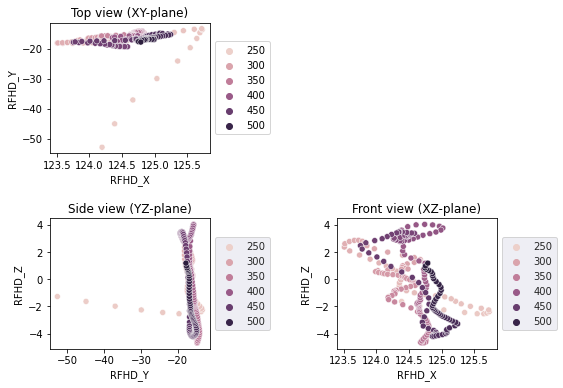

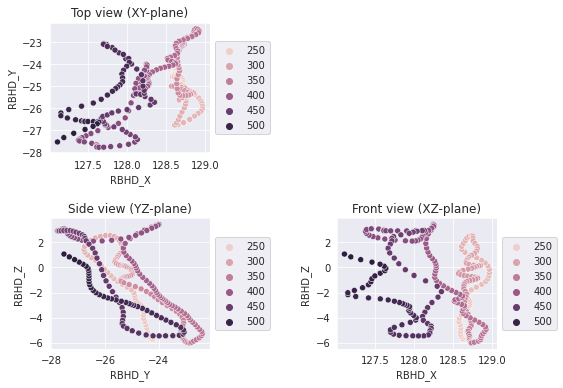

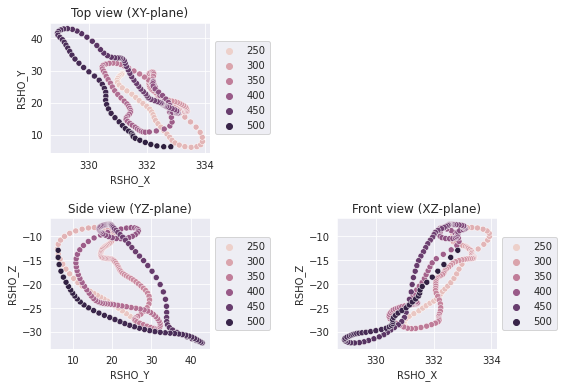

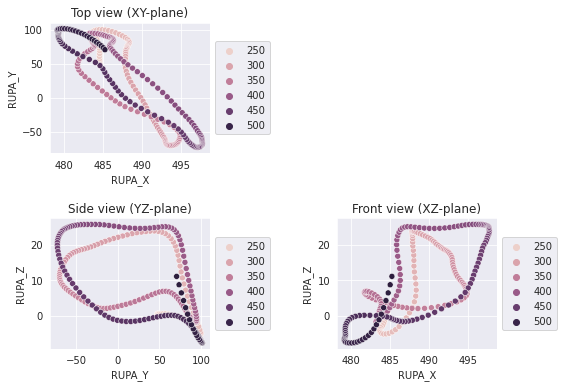

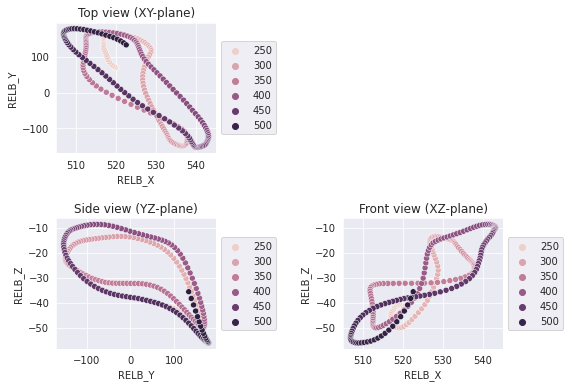

...

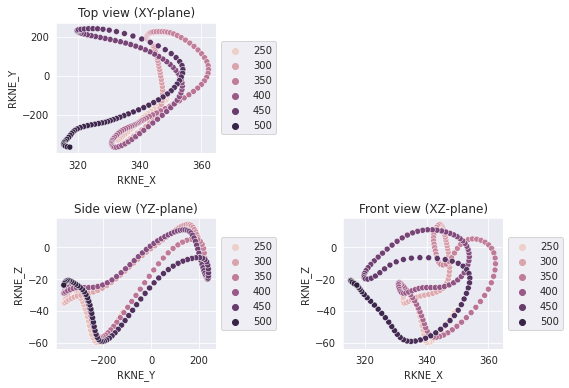

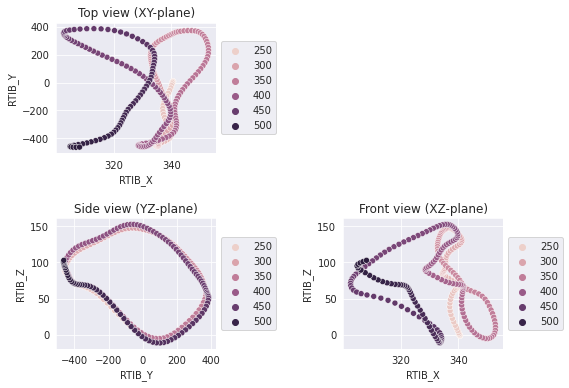

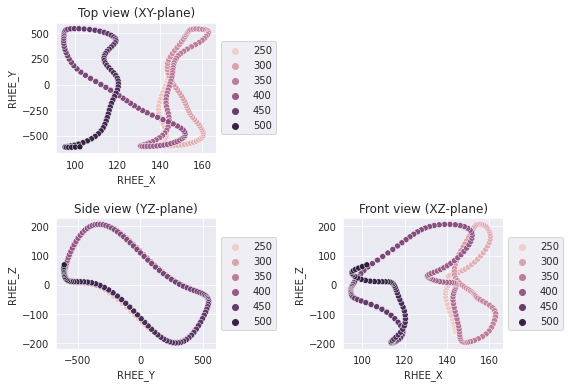

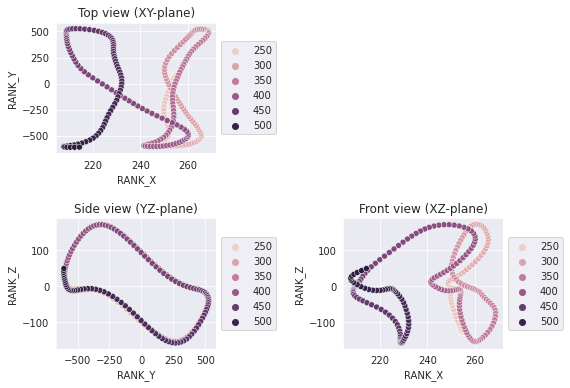

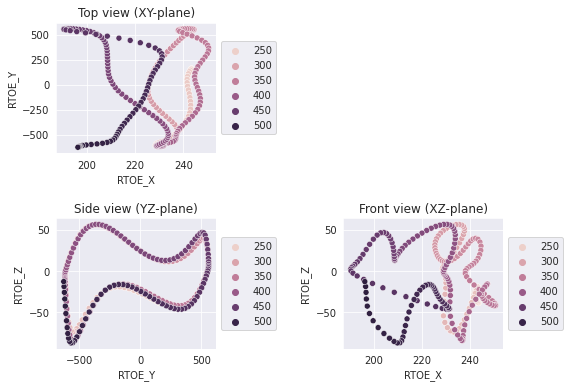

In [106]:
for placement in PAIR:
    if placement[0] == 'R':
        plot2Dprojection(data_rel_PD[0], placement)

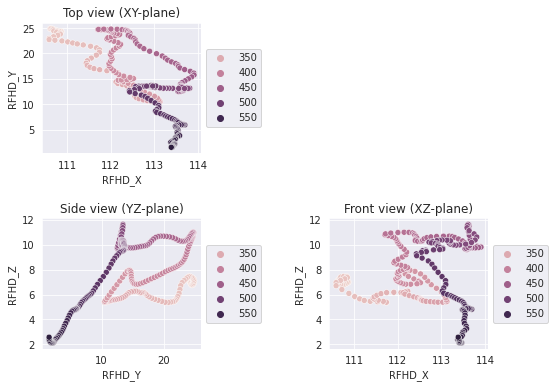

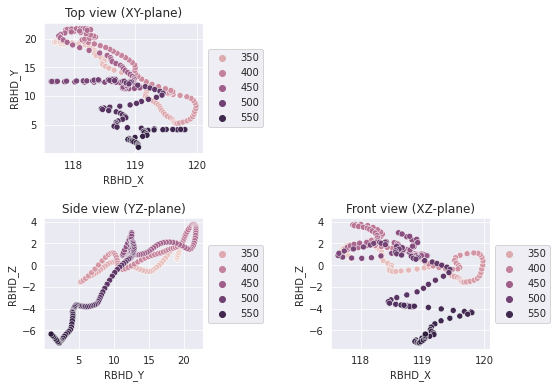

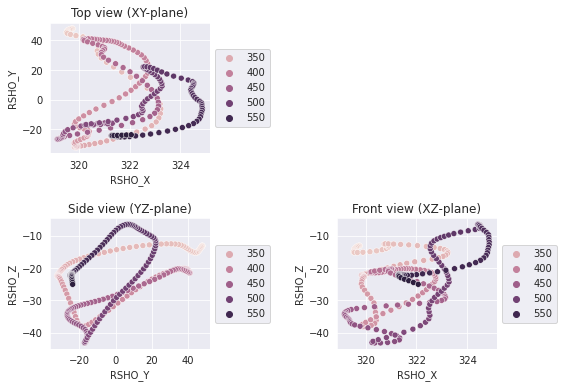

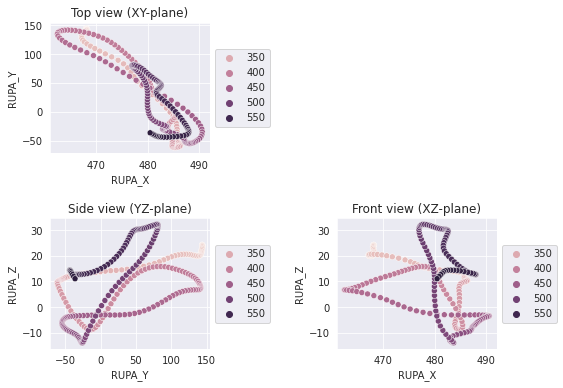

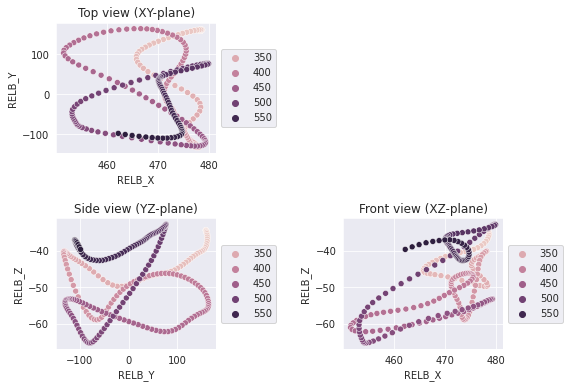

...

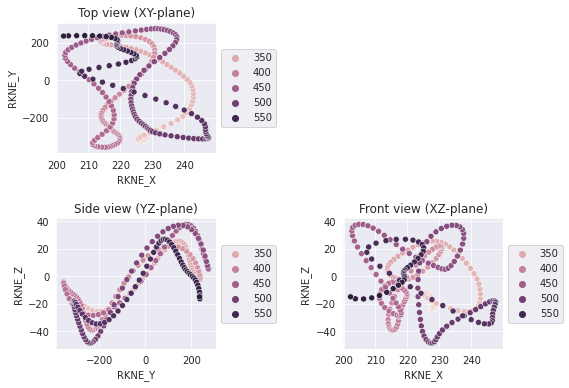

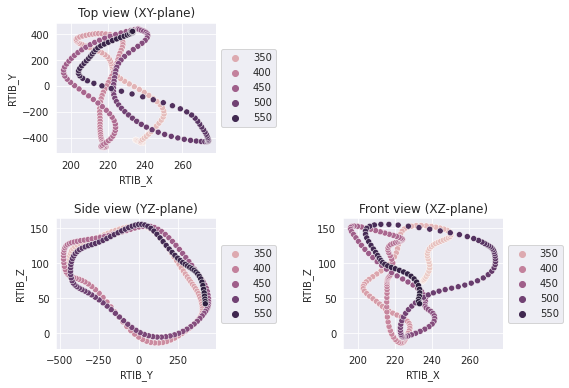

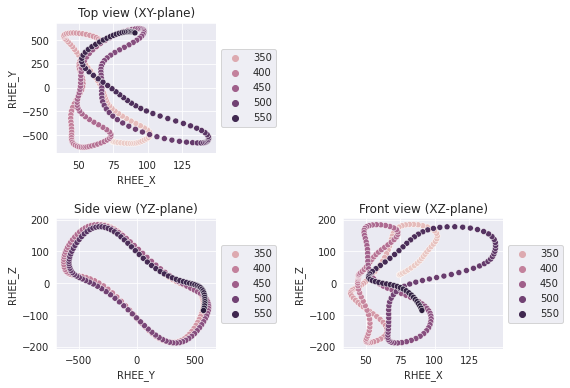

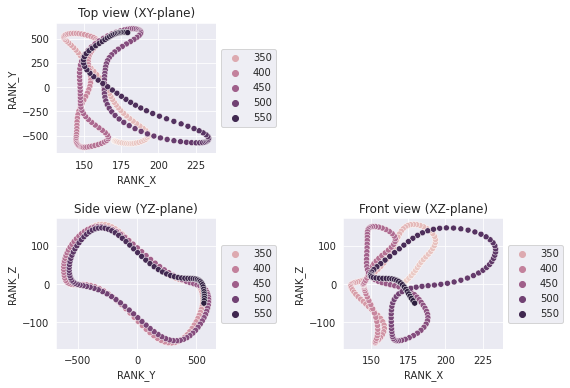

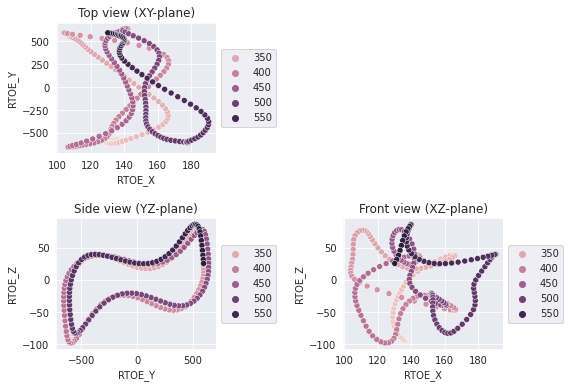

In [69]:
for placement in PAIR:
    if placement[0] == 'R':
        plot2Dprojection(data_rel_Ctrl[0], placement)